In [9]:
import os
import requests
import random
import time
from duckduckgo_search import DDGS
from tqdm import tqdm
from PIL import Image
from io import BytesIO
from tqdm.notebook import tqdm


while attempt < max_retries:
        try:
            headers = {"User-Agent": random.choice(USER_AGENTS)}  # Random User-Agent for each request
            response = requests.get(url, headers=headers, timeout=10)
            response.raise_for_status()

            img = Image.open(BytesIO(response.content))
            img.verify()  # Verify image integrity


# Configuration
queries = {
    "dogs": "dog",
    "wolves": "wolf"
}
num_images = 50
base_output_folder = "downloaded_images"
log_file = "failed_downloads.log"

# Ensure base folder exists
os.makedirs(base_output_folder, exist_ok=True)

# Rotate between different User-Agent headers
USER_AGENTS = [
    "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36",
    "Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/95.0.4638.69 Safari/537.36",
    "Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/90.0.4430.93 Safari/537.36",
# Function to log failed URLs
def log_failed_url(url):
    with open(log_file, "a") as f:
        f.write(url + "\n")

# Function to download and save an image with retries
def download_image(url, folder, index, max_retries=3):
    attempt = 0
            # Save image with appropriate extension
            ext = img.format.lower() if img.format else "jpg"
            file_path = os.path.join(folder, f"image_{index}.{ext}")

            # Reopen to properly save the image
            img = Image.open(BytesIO(response.content))
            img.save(file_path)
            
            return True
        except Exception as e:
            print(f"Attempt {attempt + 1} failed to download {url}: {e}")
            attempt += 1
            time.sleep(2)  # Wait before retrying
    
    log_failed_url(url)  # Log failed URLs
    print(f"Skipping {url} after {max_retries} failed attempts.")
    return False

# Function to fetch and download images
def fetch_and_download_images(category, search_query, num_images):
    output_folder = os.path.join(base_output_folder, category)
    os.makedirs(output_folder, exist_ok=True)

    with DDGS() as ddgs:
        image_results = ddgs.images(search_query, max_results=num_images * 3)  # Fetch more images to account for failures

    count = 0
    for result in tqdm(image_results, desc=f"Downloading {category} images"):
        if count >= num_images:
            break
#CREATED THE IMAGES

SyntaxError: expected 'except' or 'finally' block (3502680222.py, line 23)

In [6]:
#CHECKS THE TOTAL DOWNLOAD OF THE IMAGES:
        if download_image(result["image"], output_folder, count):
            count += 1

    print(f"✅ Downloaded {count} {category} images to '{output_folder}'")

# Clear previous log file
if os.path.exists(log_file):
    os.remove(log_file)

# Download images for each category
for category, search_query in queries.items():
    fetch_and_download_images(category, search_query, num_images)

print("🎉 Image download completed!")

IndentationError: unindent does not match any outer indentation level (<tokenize>, line 5)

In [11]:
import shutil
from pathlib import Path

# Define source (where images were moved to) and destination (original location)
source_folder = Path.home() / "Documents" / "VSCodeProject" / "images"
destination_folder = Path.home() / "code" / "downloaded_images"

# Move folder back
shutil.move(str(source_folder), str(destination_folder))

print(f"Moved {source_folder} back to {destination_folder}")





Moved /home/jamie/Documents/VSCodeProject/images back to /home/jamie/code/downloaded_images


In [3]:
#SHOWS WHERE THE IMAGES ARE STORRED 
import os
base_output_folder = "downloaded_images"
absolute_path = os.path.abspath(base_output_folder)
print(f"Images are saved in: {absolute_path}")

Images are saved in: /home/jamie/code/downloaded_images


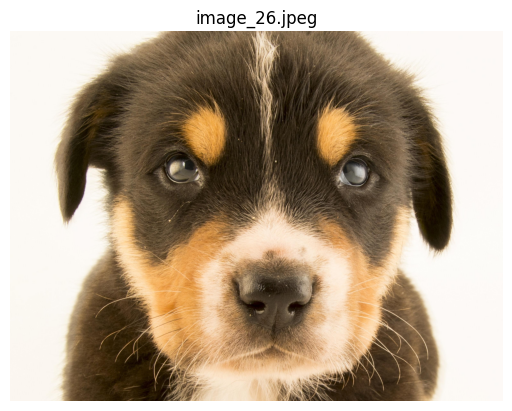

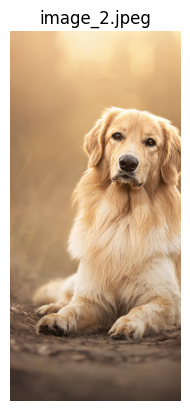

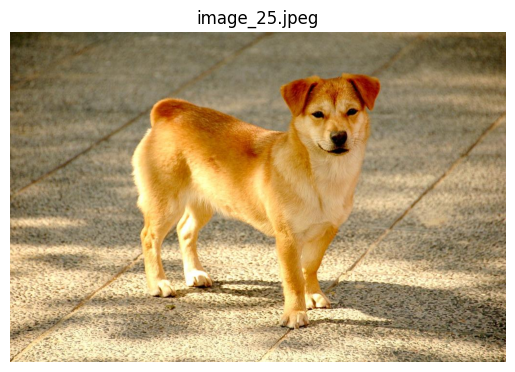

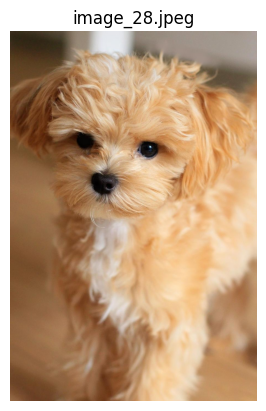

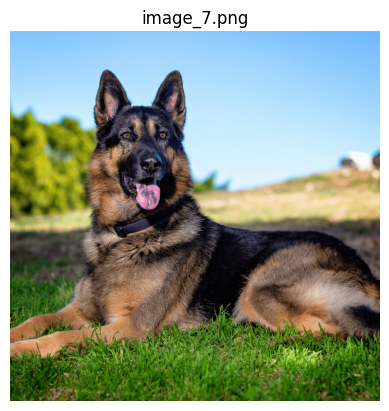

...

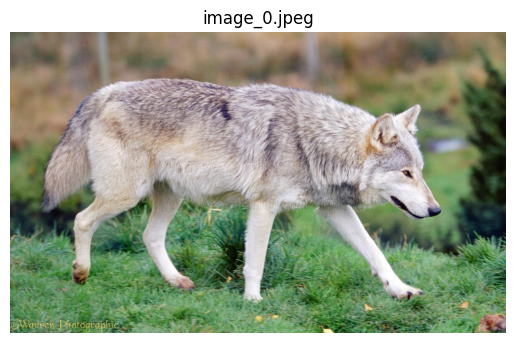

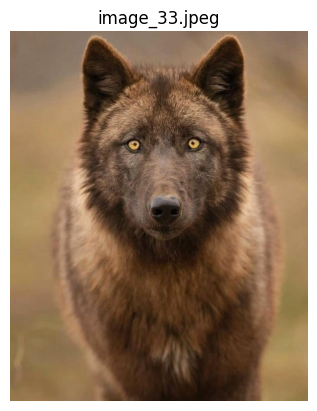

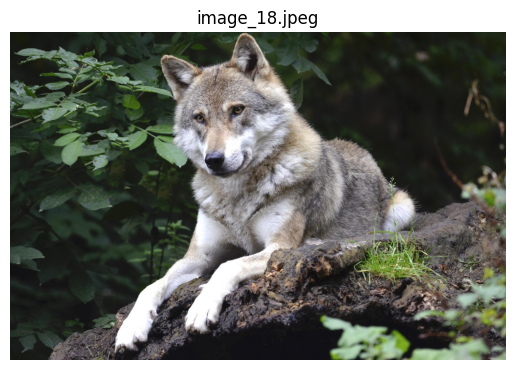

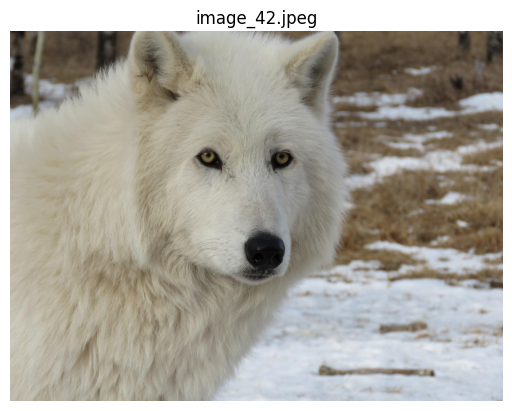

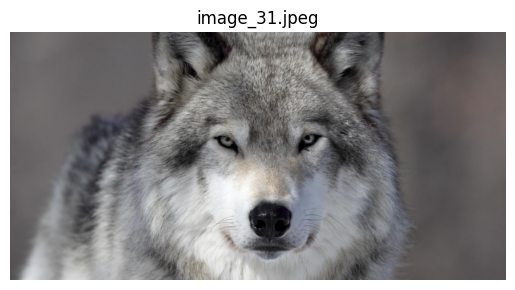

In [20]:
#Showing the images to view.
import os
from PIL import Image
import matplotlib.pyplot as plt
folder_path = '/home/jamie/code/downloaded_images/dogs'
folder_path2 = '/home/jamie/code/downloaded_images/wolves'


for filename in os.listdir(folder_path, ):
        if filename.endswith(('.jpg', '.png', '.jpeg')):
            image_path = os.path.join(folder_path, filename)
            image = Image.open(image_path)

            plt.imshow(image)
            plt.title(filename)
            plt.axis('off')
            plt.show()
for filename in os.listdir(folder_path2):
        if filename.endswith(('.jpg', '.png', '.jpeg')):
            image_path = os.path.join(folder_path2, filename)
            image = Image.open(image_path)

            plt.imshow(image)
            plt.title(filename)
            plt.axis('off')
            plt.show()

In [13]:
import subprocess
import platform
import os

folder_path = '/home/jamie/Downloads/images'

# Ensure the folder exists
if os.path.isdir(folder_path):
    # Detect the OS and open the folder accordingly
    if platform.system() == 'Linux':
        subprocess.run(['xdg-open', folder_path])
    elif platform.system() == 'Darwin':  # macOS
        subprocess.run(['open', folder_path])
    elif platform.system() == 'Windows':
        subprocess.run(['explorer', folder_path])
    else:
        print("Unsupported operating system.")
else:
    print(f"Folder does not exist: {folder_path}")



In [25]:
#Creating the data sets:import os
import random
import shutil
from pathlib import Path

# Set paths
base_path = Path("/home/jamie/code/downloaded_images")
source_dirs = {"dog": base_path / "dogs", "wolf": base_path / "wolves"}
target_dirs = {
    "train": {"dog": base_path / "train" / "dog", "wolf": base_path / "train" / "wolf"},
    "val": {"dog": base_path / "val" / "dog", "wolf": base_path / "val" / "wolf"},
}

# Create destination folders
for split in target_dirs:
    for label in target_dirs[split]:
        target_dirs[split][label].mkdir(parents=True, exist_ok=True)

# Split images and move
split_ratio = 0.8  # 80% train, 20% val

for label, src_dir in source_dirs.items():
    images = [f for f in os.listdir(src_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
    random.shuffle(images)
    split_idx = int(len(images) * split_ratio)
    
    train_images = images[:split_idx]
    val_images = images[split_idx:]

    for img in train_images:
        shutil.copy(src_dir / img, target_dirs["train"][label] / img)

    for img in val_images:
        shutil.copy(src_dir / img, target_dirs["val"][label] / img)

print("✅ Dataset split into training and validation folders.")


✅ Dataset split into training and validation folders.


In [27]:
#Creating the model:
import torch
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader
import torch.nn as nn
import torch.optim as optim
import os

# ========== Setup ==========
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

data_dir = "/home/jamie/code/downloaded_images"
train_dir = os.path.join(data_dir, "train")
val_dir = os.path.join(data_dir, "val")

# ========== Transforms ==========
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225]),
])

# ========== Load Data ==========
train_dataset = datasets.ImageFolder(train_dir, transform=transform)
val_dataset = datasets.ImageFolder(val_dir, transform=transform)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16)

class_names = train_dataset.classes
print("Classes:", class_names)

# ========== Load Pretrained Model ==========
model = models.resnet18(pretrained=True)

# Freeze all layers
for param in model.parameters():
    param.requires_grad = False

# Replace the classifier
model.fc = nn.Linear(model.fc.in_features, 2)
model = model.to(device)

# ========== Loss & Optimizer ==========
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.fc.parameters(), lr=0.001)

# ========== Training ==========
epochs = 5
for epoch in range(epochs):
    model.train()
    running_loss = 0.0

    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch {epoch+1}/{epochs}, Loss: {running_loss/len(train_loader):.4f}")

# ========== Validation ==========
model.eval()
correct = 0
total = 0

with torch.no_grad():
    for images, labels in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f"Validation Accuracy: {100 * correct / total:.2f}%")


Classes: ['dog', 'wolf']
Epoch 1/5, Loss: 0.6380
Epoch 2/5, Loss: 0.4156
Epoch 3/5, Loss: 0.2661
Epoch 4/5, Loss: 0.2121
Epoch 5/5, Loss: 0.1744
Validation Accuracy: 95.24%
